## __Random Initial Mass Fraction Generator__

For the training, testing and validation of our ANN we need to generate a proper data set in such a way that the network can perform supervised learning from it, while keeping grounded on the physics of reality.

In lay terms, this means that it would not make sense to train a network to predict values that are not possible in real life. The intended way to generate the data samples is to solve the system of stiff ordinary differential equations and use the evolution steps of the numerical solver as _input_ and _label_ sets. For this we need to provide first a set of random initial conditions (in this case initial mass fractions and temperature) to pass to an ODE solver. 

It is important that these randomly generated initial conditions agree with was is physically possible. Mathematically speaking, it is possible to generate an infinite number of initial mass fractions containing all the species involved in a given reaction mechanism, however, the existence of some of these might not be actually plausible since they could not agree with one or more conservation law. In particular we'd like our samples to comply with mass conservation.

One way this is feasible is by using Bilger's Definition for a mixture. 

## __Setting the work environment__
The libraries that will be used for this are:

- Cantera
- Numpy

In [3]:
import numpy as np
import cantera as ct

#Set printing format for numpy arrays for ease of reading
np.set_printoptions(formatter={'float': lambda x: "{0:0.4f}".format(x)})

## __Analysis of the combustion gas__

Before proceeding to generating the set of initial random condition we need to be able to obtain the chemical properties of our gas mixture. The library _Cantera_ is useful in this endeavor since it allows for the reading of information from a reaction mechanism and then provides functionality for interacting with them in Python.

In [88]:
# We read a solution mechanism and assign its properties to an object
gas = ct.Solution('../Mechanisms/WD_Laubscher.cti')

After assigning the properties of a reaction mechanism to an object, _Cantera_ provides functions to use them.

In [6]:
#Examples of some of the Cantera functions to be used:


elements=gas.element_names #Elements present in the mechanism
species=gas.species_names #Species present in the mechanism
print(' Elements in the mechanism:',elements,'\n',
     'Species in the mechanism:',species,'\n',
     'Number of atoms of Oxygen in Methane:'
      ,gas.n_atoms('CH4','O'),'\n',#Number of atoms of an element in a given species
     'Number of atoms of Oxygen in Water:'
      ,gas.n_atoms('H2O','O'),'\n',
      'Mass of Hydrogen: ', #Atomic weight of a given element present in the mechanism
      gas.atomic_weight('H'),'\n',
      'Mass of Methane: ', #Molecular weight of a given species present in the mechanism
      gas['CH4'].molecular_weights[0]
     )


 Elements in the mechanism: ['O', 'H', 'C', 'N', 'Ar'] 
 Species in the mechanism: ['CH4', 'O2', 'H2O', 'N2', 'CO', 'CO2', 'H2'] 
 Number of atoms of Oxygen in Methane: 0.0 
 Number of atoms of Oxygen in Water: 1.0 
 Mass of Hydrogen:  1.00794 
 Mass of Methane:  16.04276


Since noble gases do not interact in any reaction (footnote), the following function is designed to remove them:

In [7]:
#Noble gases filter:
def noble_filter(elements):
    filter_elements=[]
    # List of elements to be removed
    noble=['Ar','Kr','Ne','He','Rn','Xe']
    for x in elements:
        if (noble.count(x)==0):
            filter_elements.append(x)
            
    return filter_elements

In [8]:
elements=noble_filter(gas.element_names)
print('Elements without noble gases: ',elements)

Elements without noble gases:  ['O', 'H', 'C', 'N']


Using the functions described above is possible to build one that generates the matrix needes for the linear system of equations to be solved in order for the initial conditions to agree with Bilger's Definition.

## __Bilger's Definition__

Using the functions described above is possible to build one that generates the matrix needes for the linear system of equations to be solved in order for the initial conditions to agree with Bilger's Definition.

In [9]:
#Matrix for the linear system of Equations:
def bilger_matrix(gas):
    
    #Elements present in the mechanism
    elements=noble_filter(gas.element_names)
    #Species present in the mechanism
    species=gas.species_names
    
    #Matrix to store coeffiecients
    A=np.ones((len(elements)+1,len(species)))
   
    row=1;
    for x in elements:
        col=0
        for y in species:
            A[row,col]=gas.n_atoms(y,x)*gas.atomic_weight(x)/gas[y].molecular_weights[0]
            col +=1
        row +=1
    return np.copy(A)

A=bilger_matrix(gas)
print(A)

[[1.0000 1.0000 1.0000 1.0000 1.0000 1.0000 1.0000]
 [0.0000 1.0000 0.8881 0.0000 0.5712 0.7271 0.0000]
 [0.2513 0.0000 0.1119 0.0000 0.0000 0.0000 1.0000]
 [0.7487 0.0000 0.0000 0.0000 0.4288 0.2729 0.0000]
 [0.0000 0.0000 0.0000 1.0000 0.0000 0.0000 0.0000]]


As for the resulting vector, it will be created using random mixture fractions of a fuel and an oxydizer. Python dictionaries bestow a simple way to storing this information. For the results to be reproducible, it is necessary to use a seeded random number generator. Nonetheles the implementation of it won't come until later.

In [10]:
#Dictionaries for oxydizer and fuel mass fractions:
fuel={'H':0.03922422,'O':0.19663877,'C':0.11684286,'N':0.64729}
oxy={'H':1.03625e-5,'O':0.23298543,'C':3.194117e-5,'N':0.766970811}

def bilger_vector(f_mix, fuel_dict, oxy_dict, elements):
    
    b=np.ones(len(elements)+1)
    row=1
    for x in elements:
        b[row]=f_mix*fuel_dict[x]+(1-f_mix)*oxy_dict[x]
        row+=1
    return np.copy(b)

In [11]:
np.random.seed(0)
rn=np.random.randn(1)
b=bilger_vector(rn,fuel, oxy, elements)
print(b)

[1.0000 0.1689 0.0692 0.2061 0.5558]


Now is possible to see both the coefficient matrix and result vector needed to solve the linear system Ax=b. 

In [12]:
print("A =\n\n",A)
print("\nb.transpose =\n\n",b)

A =

 [[1.0000 1.0000 1.0000 1.0000 1.0000 1.0000 1.0000]
 [0.0000 1.0000 0.8881 0.0000 0.5712 0.7271 0.0000]
 [0.2513 0.0000 0.1119 0.0000 0.0000 0.0000 1.0000]
 [0.7487 0.0000 0.0000 0.0000 0.4288 0.2729 0.0000]
 [0.0000 0.0000 0.0000 1.0000 0.0000 0.0000 0.0000]]

b.transpose =

 [1.0000 0.1689 0.0692 0.2061 0.5558]


## __Solving the linear system__

Once the system of equations is setted up it is neccesary to solve it for the species mass fractions. Unfortunately, as can be seen, this is an undetermined system (i.e. it has more unknowns thant equations) and thus, in the case it can be solved, this solution will not be unique. To deal with this issue there are two possibilities using either a least-squares solver or a non-negative least squares solver. Both will provide an approximation of the solution by minimizing the squared euclidean norm:

However, they differ in certain aspects, and thus is necessary to analyze the distribution of the samples generated with each in order to select an appropiate method. 

In [33]:
#Solution of the linear system via least squares solver
import pandas as pd
S=[]
F=[]
A=bilger_matrix(gas)
np.random.seed(0)
f_max=1
f_min=0
for i in range(10000):
    f=np.random.random(1)*(f_max-f_min)+f_min
    b=bilger_vector(f[0],fuel, oxy, noble_filter(elements))
    z=np.linalg.lstsq(A, b,rcond=None)[0:]
    S.append(z[0])
    F.append(f[0])
df1=pd.DataFrame(S,columns=gas.species_names)
df1['Mixture']=F
df1.head()

,CH4,O2,H2O,N2,CO,CO2,H2,Mixture
0,0.029103,0.074193,0.066647,0.701289,0.058074,0.063934,0.006760,0.548814
1,0.049822,0.067301,0.060748,0.681377,0.065719,0.066294,0.008738,0.715189
2,0.035821,0.071958,0.064734,0.694832,0.060553,0.064699,0.007402,0.602763
3,0.028614,0.074355,0.066786,0.701759,0.057893,0.063878,0.006714,0.544883
4,0.013517,0.079377,0.071085,0.716268,0.052322,0.062158,0.005273,0.423655


In [34]:
#Solution of the linear system via non-negative least squares solver
import pandas as pd
from scipy.optimize import nnls 
S=[]
F=[]
A=bilger_matrix(gas)
np.random.seed(0)
f_max=1
f_min=0
for i in range(10000):
    f=np.random.random(1)*(f_max-f_min)+f_min
    b=bilger_vector(f[0],fuel, oxy, noble_filter(elements))
    z,rnorm=nnls(A,b)
    S.append(z)
    F.append(f[0])
df2=pd.DataFrame(S,columns=gas.species_names)
df2['Mixture']=F
df2.head()

,CH4,O2,H2O,N2,CO,CO2,H2,Mixture
0,0.085670,0.213038,0.0,0.701289,0.0,0.0,0.000002,0.548814
1,0.111628,0.206991,0.0,0.681377,0.0,0.0,0.000003,0.715189
2,0.094087,0.211078,0.0,0.694832,0.0,0.0,0.000002,0.602763
3,0.085057,0.213181,0.0,0.701759,0.0,0.0,0.000002,0.544883
4,0.066142,0.217588,0.0,0.716268,0.0,0.0,0.000002,0.423655


### __Distribution of the data samples__

#### __CH4__

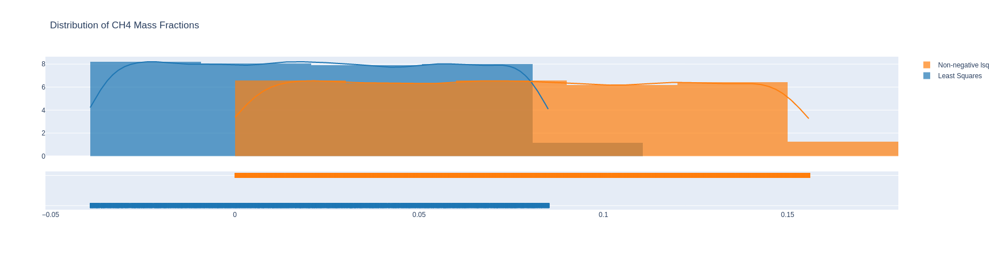

In [35]:
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
specie=[df1['CH4'],df2['CH4']]
group_labels = ['Least Squares', 'Non-negative lsq']
fig = ff.create_distplot(specie, group_labels,bin_size=.03)
fig.update_layout(
    title="Distribution of CH4 Mass Fractions"
)
fig.show()

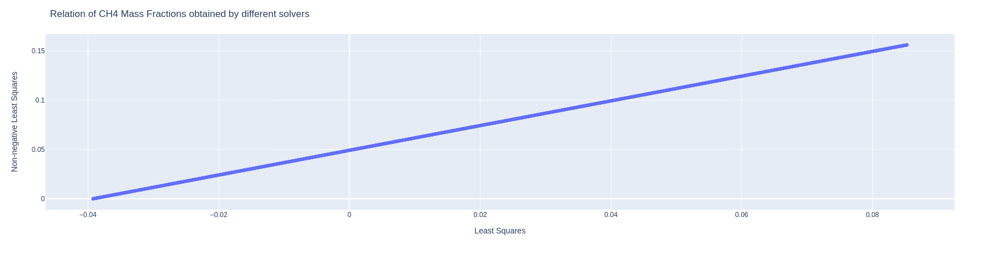

In [36]:
import plotly.express as px
fig = px.scatter(x=specie[0], y=specie[1])
fig.update_layout(
    title="Relation of CH4 Mass Fractions obtained by different solvers",
    xaxis_title="Least Squares",
    yaxis_title="Non-negative Least Squares"
)

fig.show()

#### __O2__

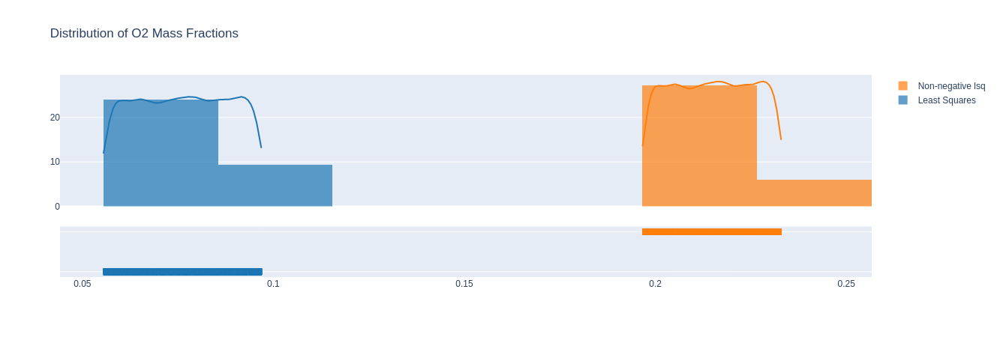

In [37]:
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
specie=[df1['O2'],df2['O2']]
group_labels = ['Least Squares', 'Non-negative lsq']
fig = ff.create_distplot(specie, group_labels,bin_size=.03)
fig.update_layout(
    title="Distribution of O2 Mass Fractions"
)
fig.show()

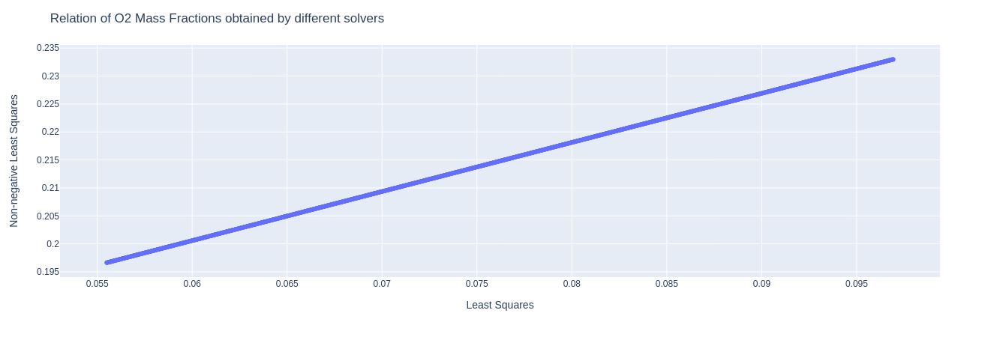

In [38]:
import plotly.express as px
fig = px.scatter(x=specie[0], y=specie[1])
fig.update_layout(
    title="Relation of O2 Mass Fractions obtained by different solvers",
    xaxis_title="Least Squares",
    yaxis_title="Non-negative Least Squares"
)
fig.show()

### __H2O__

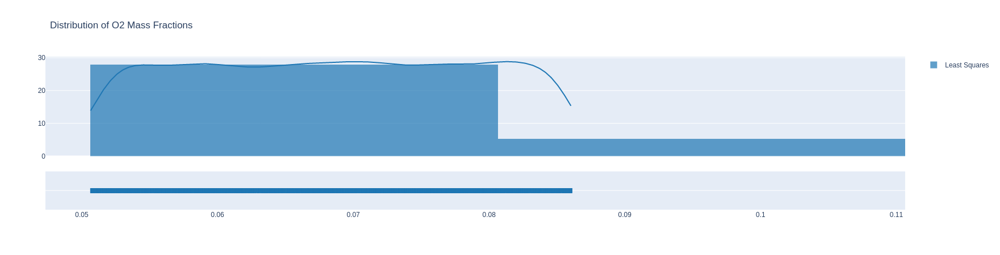

In [45]:
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
specie=[df1['H2O']]
group_labels = ['Least Squares']
fig = ff.create_distplot(specie, group_labels,bin_size=.03)
fig.update_layout(
    title="Distribution of O2 Mass Fractions"
)
fig.show()

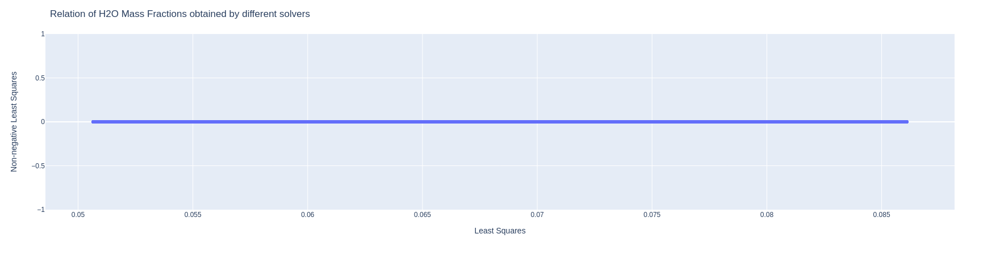

In [46]:
import plotly.express as px
fig = px.scatter(x=specie[0], y=df2['H2O'])
fig.update_layout(
    title="Relation of H2O Mass Fractions obtained by different solvers",
    xaxis_title="Least Squares",
    yaxis_title="Non-negative Least Squares"
)
fig.show()

### __N2__

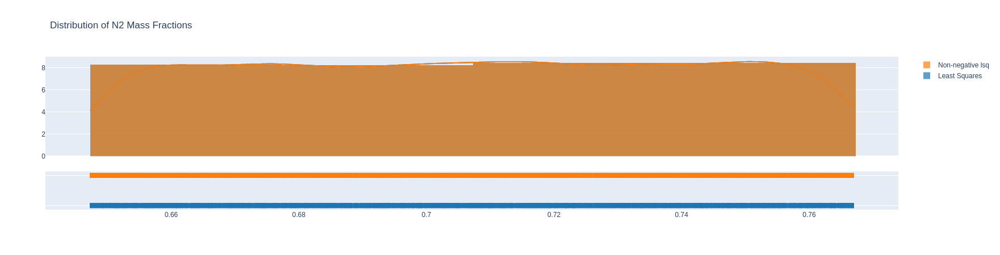

In [47]:
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
specie=[df1['N2'],df2['N2']]
group_labels = ['Least Squares', 'Non-negative lsq']
fig = ff.create_distplot(specie, group_labels,bin_size=.03)
fig.update_layout(
    title="Distribution of N2 Mass Fractions"
)
fig.show()

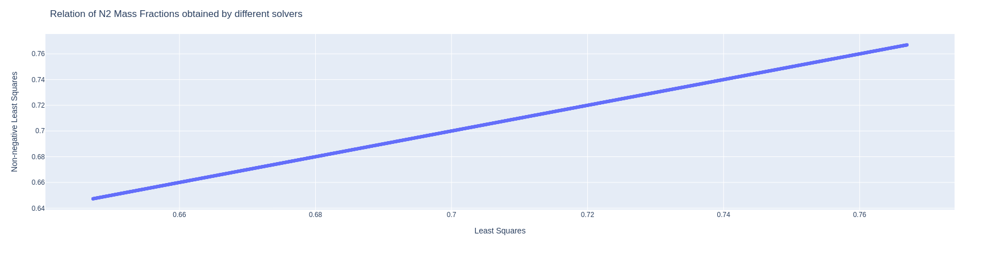

In [48]:
import plotly.express as px
fig = px.scatter(x=specie[0], y=specie[1])
fig.update_layout(
    title="Relation of N2 Mass Fractions obtained by different solvers",
    xaxis_title="Least Squares",
    yaxis_title="Non-negative Least Squares"
)
fig.show()

### __CO__

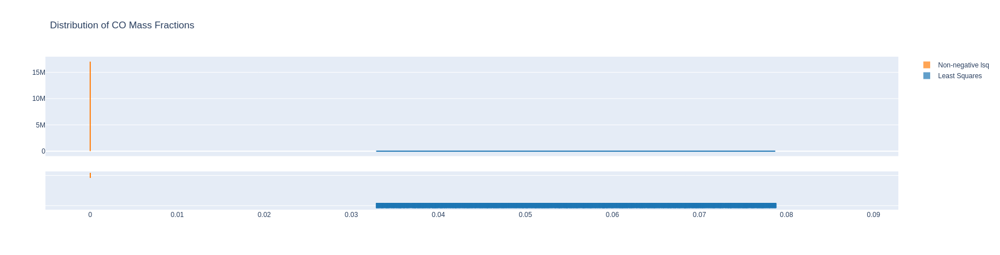

In [49]:
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
specie=[df1['CO'],df2['CO']]
group_labels = ['Least Squares', 'Non-negative lsq']
fig = ff.create_distplot(specie, group_labels,bin_size=.03)
fig.update_layout(
    title="Distribution of CO Mass Fractions"
)
fig.show()

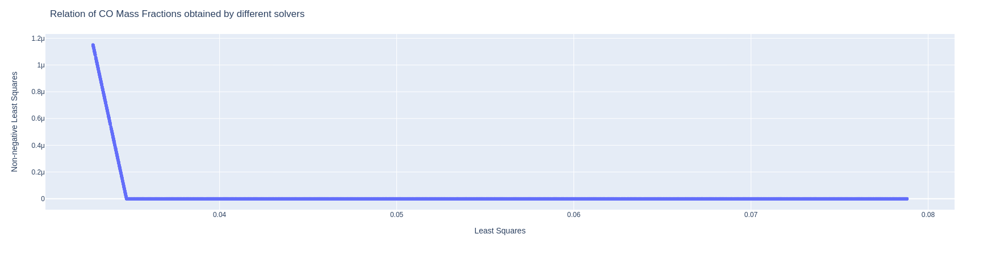

In [50]:
import plotly.express as px
fig = px.scatter(x=specie[0], y=specie[1])
fig.update_layout(
    title="Relation of CO Mass Fractions obtained by different solvers",
    xaxis_title="Least Squares",
    yaxis_title="Non-negative Least Squares"
)
fig.show()

### __CO2__


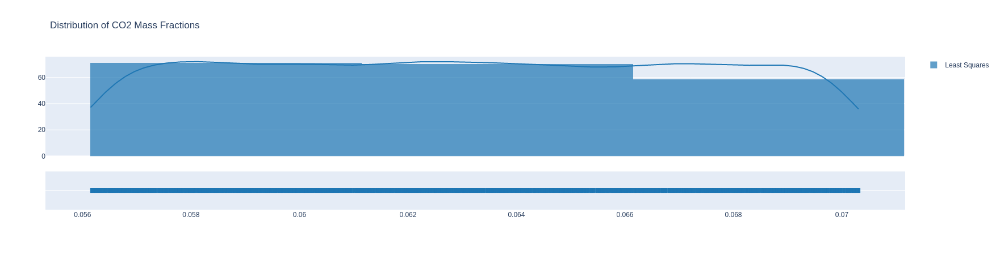

In [51]:
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
specie=[df1['CO2']]
group_labels = ['Least Squares']
fig = ff.create_distplot(specie, group_labels,bin_size=.005)
fig.update_layout(
    title="Distribution of CO2 Mass Fractions"
)
fig.show()

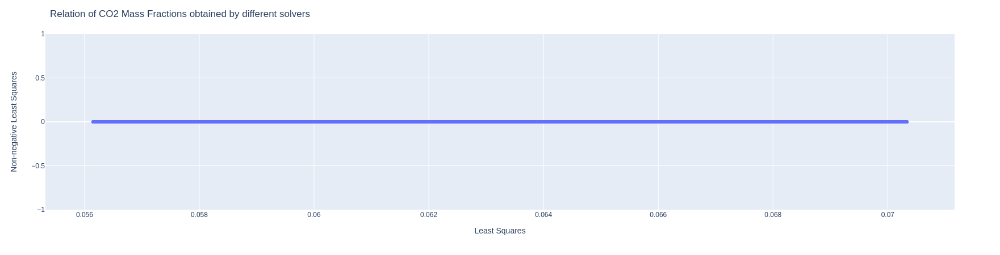

In [53]:
import plotly.express as px
fig = px.scatter(x=specie[0], y=df2['CO2'])
fig.update_layout(
    title="Relation of CO2 Mass Fractions obtained by different solvers",
    xaxis_title="Least Squares",
    yaxis_title="Non-negative Least Squares"
)
fig.show()

### __H2__

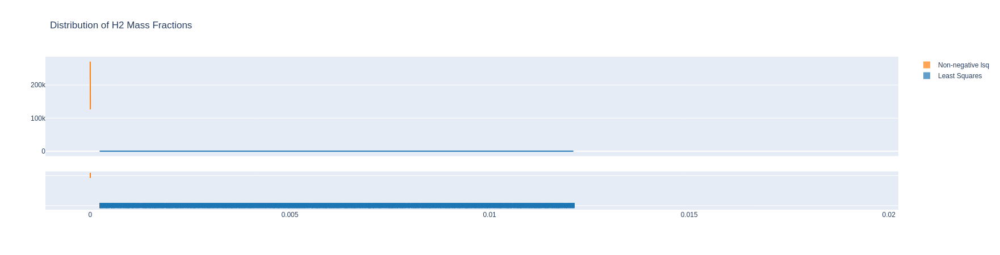

In [54]:
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
specie=[df1['H2'],df2['H2']]
group_labels = ['Least Squares', 'Non-negative lsq']
fig = ff.create_distplot(specie, group_labels,bin_size=.01)
fig.update_layout(
    title="Distribution of H2 Mass Fractions"
)
fig.show()

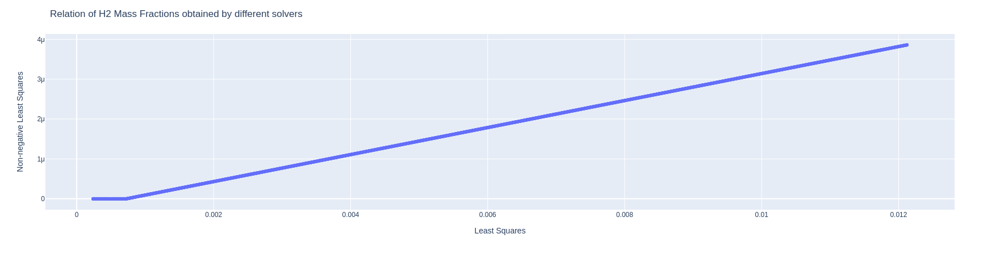

In [55]:
import plotly.express as px
fig = px.scatter(x=specie[0], y=specie[1])
fig.update_layout(
    title="Relation of H2 Mass Fractions obtained by different solvers",
    xaxis_title="Least Squares",
    yaxis_title="Non-negative Least Squares"
)
fig.show()

## __Final Solution of the linear system:__

Since it was seen that the least squares method generates a lot of negative mass fractions, while the non-negative least squares produces a lot of zeroes an obvious idea would be to combine both methods in such a way that they compliment each other. From observing the scatter graphs of the extant species, one could observe that in most cases, whenever a negative value is created using the least squares solver, the non-negative one returns a zero value. Combined in this way the negative mass fractions are dealt with while avoiding that for certain species, only zero fractions are returned (which is the main problem when using nnls).

Using this approach, it is now possible to define a functions that utilizes both solvers.

In [69]:
# Define a function to Generate random temperatures and mass fractions

def TY_Generator(seed,samples,gas,fuel_dict,oxy_dict,f_max=0.6,f_min=0.1,T_max=3000,T_min=300):
    S=[]
    F=[]
    A=bilger_matrix(gas)
    np.random.seed(seed)
    T=np.random.random(samples)*(T_max-T_min)+T_min
    np.random.seed(seed)
    for i in range(samples):
        f=np.random.random(1)*(f_max-f_min)+f_min
        b=bilger_vector(f[0],fuel_dict, oxy_dict, noble_filter(gas.element_names))
        z=np.linalg.lstsq(A, b,rcond=None)[0:]
        if (z[0][0]>=0):
            S.append(z[0])
        else:
            z,rnorm=nnls(A,b)
            S.append(z)
    YInit=np.array(S)
    return (np.copy(T),np.copy(YInit))

In [89]:
# Testing

#Dictionaries for oxydizer and fuel mass fractions:
fuel={'H':0.03922422,'O':0.19663877,'C':0.11684286,'N':0.64729}
oxy={'H':1.03625e-5,'O':0.23298543,'C':3.194117e-5,'N':0.766970811}
#Parameters:
samples=200
gas=ct.Solution('../Mechanisms/WD_Laubscher.cti')
seed=0

T,YInit=TY_Generator(seed,samples,gas,fuel,oxy,f_max=1,f_min=0)
Fractions=pd.DataFrame(YInit,columns=gas.species_names)

In [75]:
Fractions.head()

,CH4,O2,H2O,N2,CO,CO2,H2
0,0.029103,0.074193,0.066647,0.701289,0.058074,0.063934,0.006760
1,0.049822,0.067301,0.060748,0.681377,0.065719,0.066294,0.008738
2,0.035821,0.071958,0.064734,0.694832,0.060553,0.064699,0.007402
3,0.028614,0.074355,0.066786,0.701759,0.057893,0.063878,0.006714
4,0.013517,0.079377,0.071085,0.716268,0.052322,0.062158,0.005273


### __Distribution of the Mass Fractions__

To finish, it is important once again to check the distribution of the mass fractions for each indivifual species.

#### __CH4__:

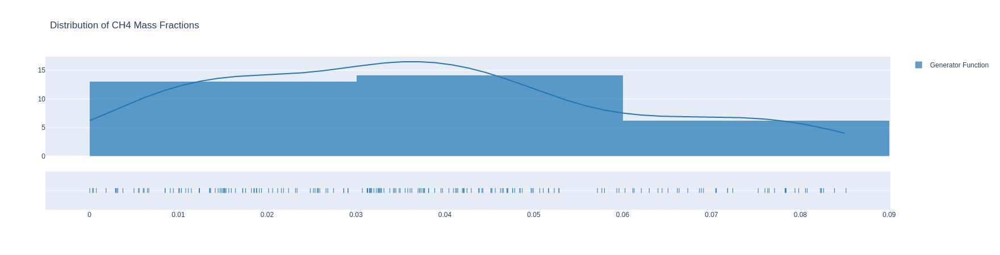

In [81]:
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
specie=[Fractions['CH4']]
group_labels = ['Generator Function']
fig = ff.create_distplot(specie, group_labels,bin_size=.03)
fig.update_layout(
    title="Distribution of CH4 Mass Fractions"
)
fig.show()

#### __O2__:

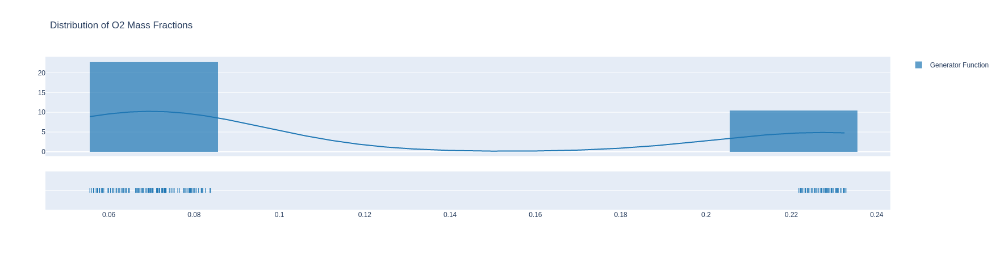

In [82]:
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
specie=[Fractions['O2']]
group_labels = ['Generator Function']
fig = ff.create_distplot(specie, group_labels,bin_size=.03)
fig.update_layout(
    title="Distribution of O2 Mass Fractions"
)
fig.show()

#### __H2O__:

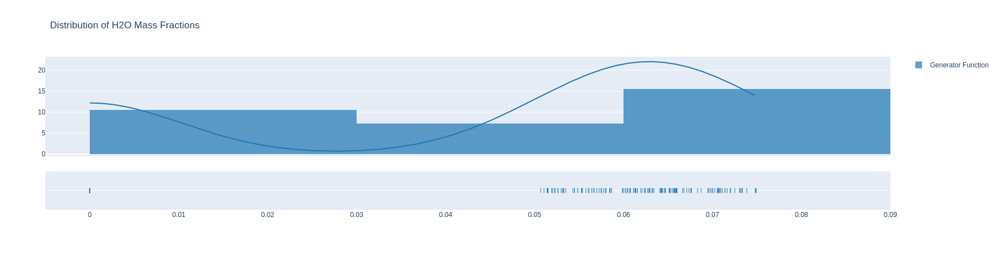

In [83]:
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
specie=[Fractions['H2O']]
group_labels = ['Generator Function']
fig = ff.create_distplot(specie, group_labels,bin_size=.03)
fig.update_layout(
    title="Distribution of H2O Mass Fractions"
)
fig.show()

#### __N2__:

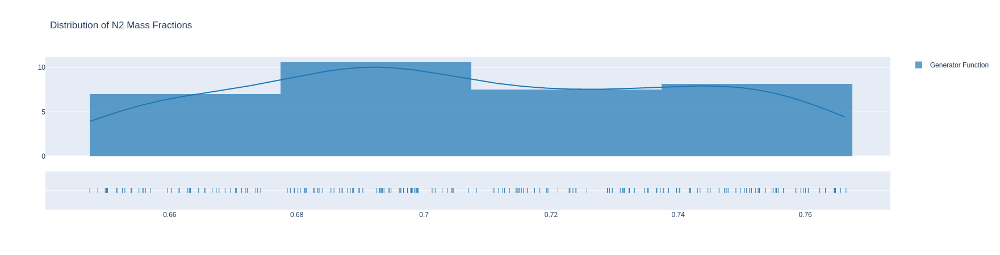

In [84]:
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
specie=[Fractions['N2']]
group_labels = ['Generator Function']
fig = ff.create_distplot(specie, group_labels,bin_size=.03)
fig.update_layout(
    title="Distribution of N2 Mass Fractions"
)
fig.show()

#### __CO__:

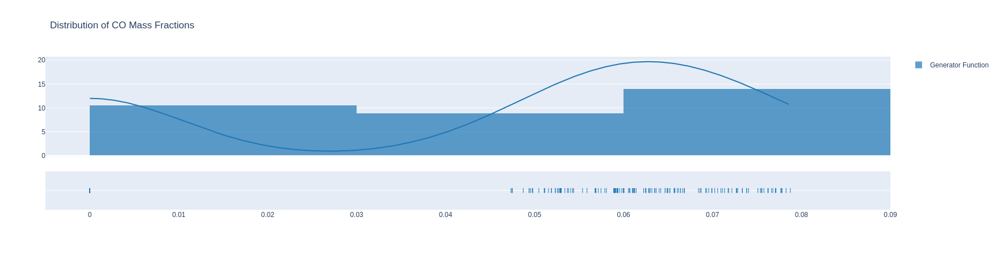

In [85]:
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
specie=[Fractions['CO']]
group_labels = ['Generator Function']
fig = ff.create_distplot(specie, group_labels,bin_size=.03)
fig.update_layout(
    title="Distribution of CO Mass Fractions"
)
fig.show()

#### __CO2__:

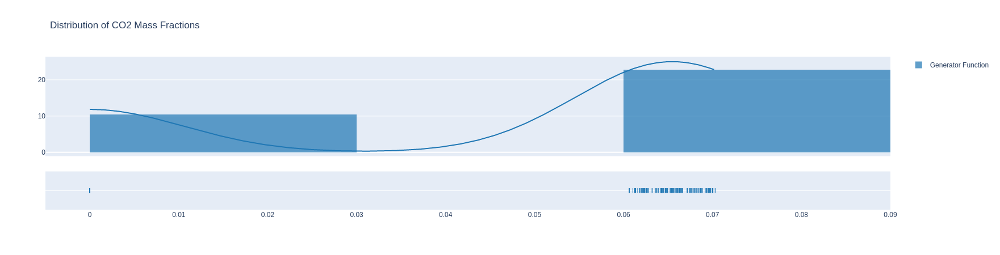

In [86]:
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
specie=[Fractions['CO2']]
group_labels = ['Generator Function']
fig = ff.create_distplot(specie, group_labels,bin_size=.03)
fig.update_layout(
    title="Distribution of CO2 Mass Fractions"
)
fig.show()

#### __H2__:

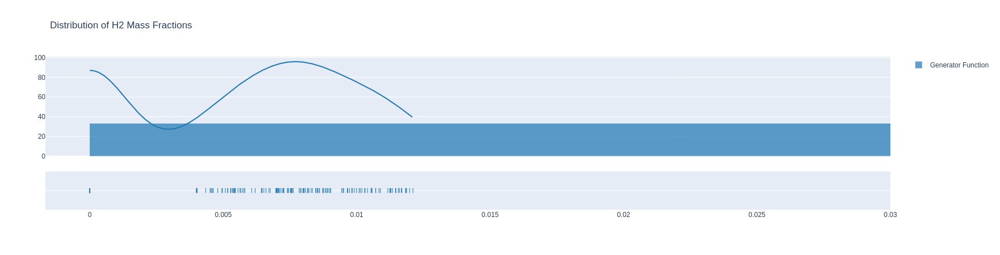

In [87]:
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
specie=[Fractions['H2']]
group_labels = ['Generator Function']
fig = ff.create_distplot(specie, group_labels,bin_size=.03)
fig.update_layout(
    title="Distribution of H2 Mass Fractions"
)
fig.show()